### Get lagged data

According to the *Interim Estimates of Vaccine Effectiveness of BNT162b2 and mRNA-1273 COVID-19 Vaccines in Preventing SARS-CoV-2 Infection Among Health Care Personnel, First Responders, and Other Essential and Frontline Workers — Eight U.S. Locations, December 2020–March 2021* published by CDC, the effectiveness of vaccines has around 14 days lag. Thus, we will add two column **vaccine lag-7** and **vaccine lag-14** for our analysis.

In [140]:
! pip3 install shap

In [141]:
import pandas as pd
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import statsmodels.api as sm
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import shap
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn import tree
from sklearn.model_selection import GridSearchCV
import seaborn as sn

In [142]:
data = pd.read_csv("data.csv")

In [143]:
data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct'],
      dtype='object')

In [144]:
min(data["date"])

'2021-01-01'

In [145]:
max(data["date"])

'2021-04-20'

In [146]:
data = data.replace("no value", None)

In [147]:
data["retail_and_recreation_percent_change_from_baseline"] = data["retail_and_recreation_percent_change_from_baseline"] / 100
data["grocery_and_pharmacy_percent_change_from_baseline"] = data["grocery_and_pharmacy_percent_change_from_baseline"] / 100
data["parks_percent_change_from_baseline"] = data["parks_percent_change_from_baseline"].astype(float) / 100
data["transit_stations_percent_change_from_baseline"] = data["transit_stations_percent_change_from_baseline"] / 100
data["workplaces_percent_change_from_baseline"] = data["workplaces_percent_change_from_baseline"] / 100
data["residential_percent_change_from_baseline"] = data["residential_percent_change_from_baseline"] / 100

In [148]:
new_data = pd.DataFrame()
for state in data["state"].unique():
    s = data[data["state"] == state]
    s["people_fully_vaccinated_per_hundred_lag7"] = s["people_fully_vaccinated_per_hundred"].shift(7)
    s["people_fully_vaccinated_per_hundred_lag14"] = s["people_fully_vaccinated_per_hundred"].shift(14)
    s["daily_vaccinations_per_million_lag7"] = s["daily_vaccinations_per_million"].shift(7)
    s["daily_vaccinations_per_million_lag14"] = s["daily_vaccinations_per_million"].shift(14)
    s["retail_and_recreation_percent_change_lag7"] = s["retail_and_recreation_percent_change_from_baseline"].shift(7)
    s["grocery_and_pharmacy_percent_change_lag7"] = s["grocery_and_pharmacy_percent_change_from_baseline"].shift(7)
    s["parks_percent_change_lag7"] = s["parks_percent_change_from_baseline"].shift(7)
    s["transit_stations_percent_change_lag7"] = s["transit_stations_percent_change_from_baseline"].shift(7)
    s["workplaces_percent_change_lag7"] = s["workplaces_percent_change_from_baseline"].shift(7)
    s["residential_percent_change_lag7"] = s["residential_percent_change_from_baseline"].shift(7)
    s["retail_and_recreation_percent_change_lag14"] = s["retail_and_recreation_percent_change_from_baseline"].shift(14)
    s["grocery_and_pharmacy_percent_change_lag14"] = s["grocery_and_pharmacy_percent_change_from_baseline"].shift(14)
    s["parks_percent_change_lag14"] = s["parks_percent_change_from_baseline"].shift(14)
    s["transit_stations_percent_change_lag14"] = s["transit_stations_percent_change_from_baseline"].shift(14)
    s["workplaces_percent_change_lag14"] = s["workplaces_percent_change_from_baseline"].shift(14)
    s["residential_percent_change_lag14"] = s["residential_percent_change_from_baseline"].shift(14)
    new_data = new_data.append(s)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

In [149]:
new_data = new_data[pd.to_datetime(new_data["date"]) > pd.to_datetime("01/01/2021")]

In [150]:
new_data.describe()

,Unnamed: 0,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline,stay_at_home,mask_mandate,business_open,...,parks_percent_change_lag7,transit_stations_percent_change_lag7,workplaces_percent_change_lag7,residential_percent_change_lag7,retail_and_recreation_percent_change_lag14,grocery_and_pharmacy_percent_change_lag14,parks_percent_change_lag14,transit_stations_percent_change_lag14,workplaces_percent_change_lag14,residential_percent_change_lag14
count,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,5559.000000,...,5253.000000,5253.000000,5253.000000,5253.000000,4896.000000,4896.000000,4896.000000,4896.000000,4896.000000,4896.000000
mean,2805.000000,-0.156008,-0.068550,0.050149,-0.243828,-0.251599,0.083562,0.019608,0.693110,0.348804,...,0.024649,-0.254146,-0.258011,0.087175,-0.174295,-0.080758,-0.003150,-0.263246,-0.259990,0.089563
std,1619.607526,0.133389,0.094471,0.381044,0.197465,0.114062,0.046567,0.138661,0.461245,0.496963,...,0.362647,0.197182,0.123942,0.049649,0.133477,0.097713,0.344182,0.193751,0.125341,0.049718
min,1.000000,-0.790000,-0.660000,-0.760000,-0.840000,-0.860000,-0.040000,0.000000,0.000000,0.000000,...,-0.760000,-0.870000,-0.860000,-0.040000,-0.790000,-0.660000,-0.760000,-0.870000,-0.860000,-0.040000
25%,1402.500000,-0.230000,-0.120000,-0.210000,-0.390000,-0.320000,0.050000,0.000000,0.000000,0.000000,...,-0.220000,-0.400000,-0.330000,0.050000,-0.250000,-0.130000,-0.230000,-0.400000,-0.330000,0.060000
50%,2805.000000,-0.150000,-0.070000,-0.040000,-0.240000,-0.250000,0.080000,0.000000,1.000000,0.000000,...,-0.050000,-0.250000,-0.250000,0.080000,-0.170000,-0.080000,-0.070000,-0.270000,-0.250000,0.080000
75%,4207.500000,-0.070000,-0.010000,0.220000,-0.110000,-0.170000,0.110000,0.000000,1.000000,1.000000,...,0.190000,-0.120000,-0.170000,0.110000,-0.090000,-0.020000,0.140000,-0.130000,-0.170000,0.120000
max,5609.000000,0.200000,0.330000,2.570000,0.440000,0.000000,0.360000,1.000000,1.000000,2.000000,...,2.570000,0.440000,0.000000,0.360000,0.200000,0.330000,2.170000,0.340000,0.000000,0.360000


In [151]:
import matplotlib.pyplot as plt

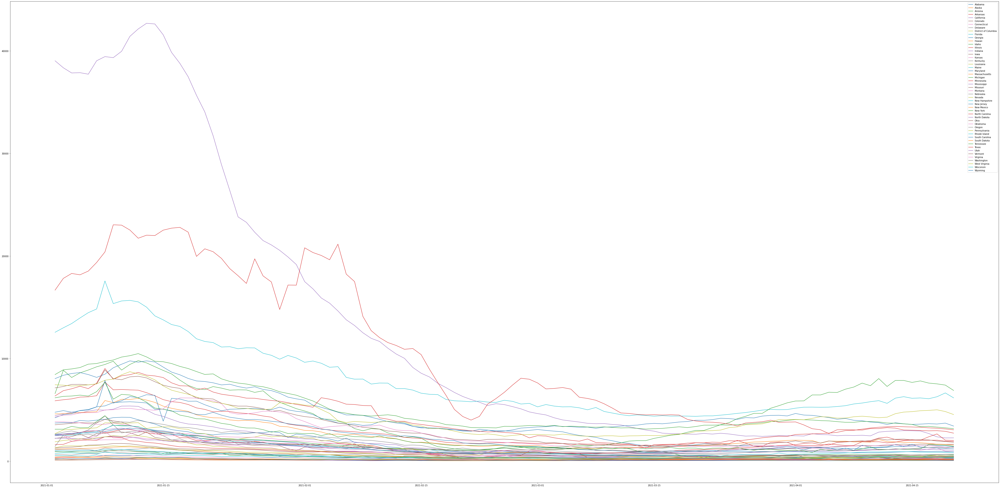

In [152]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

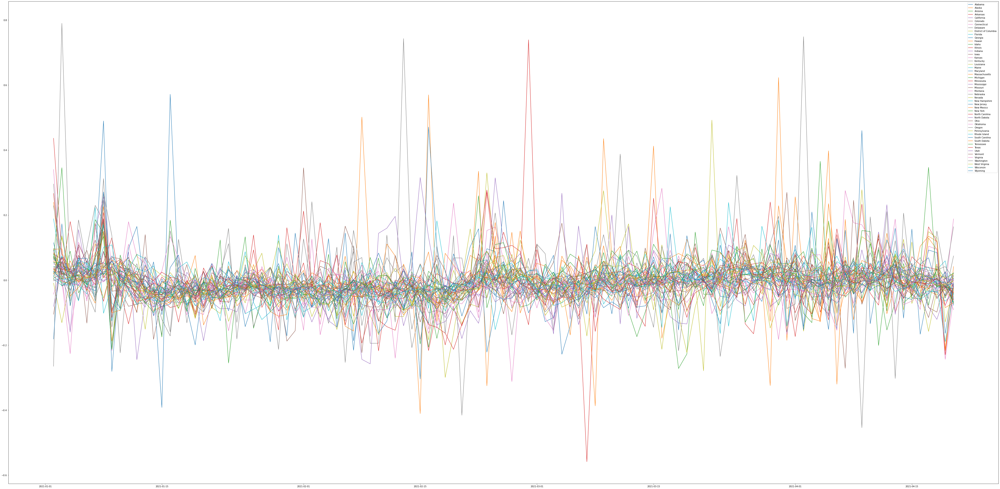

In [153]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_growth_rate"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

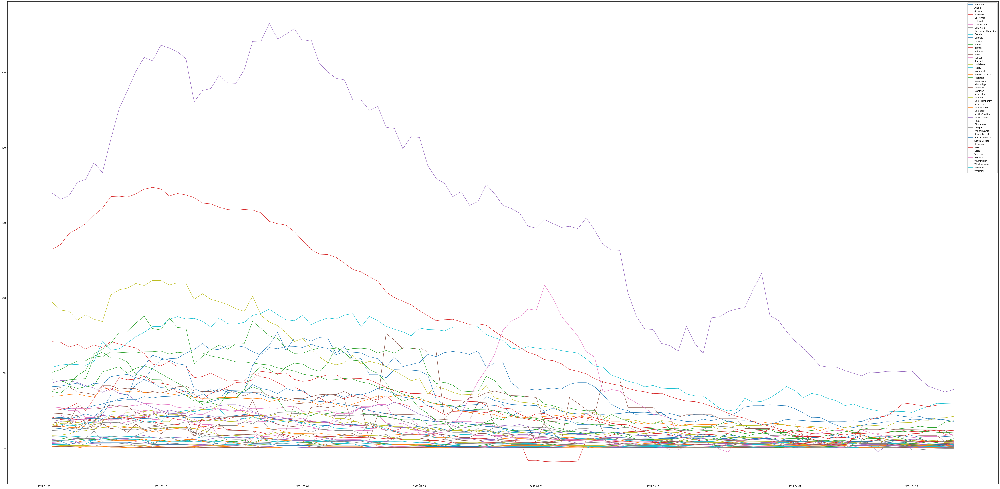

In [154]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_death_ma7"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

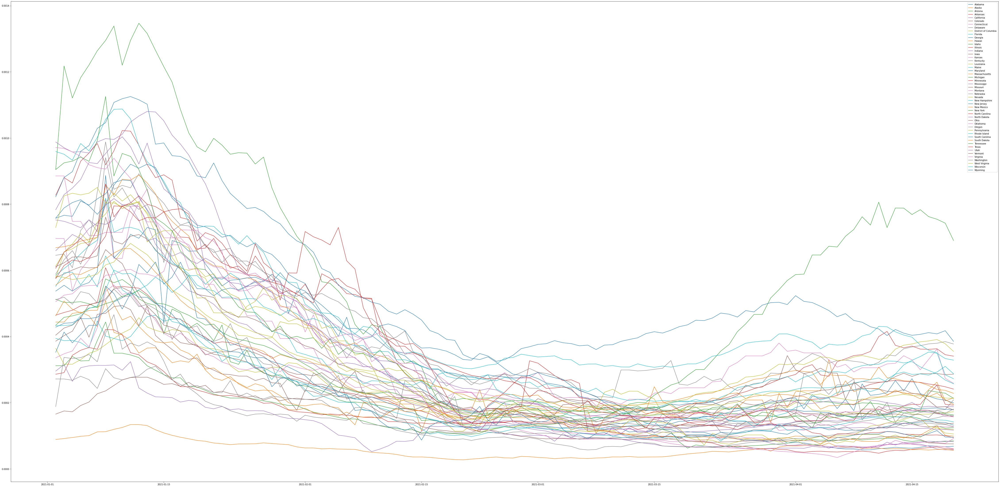

In [155]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["new_case_pct"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

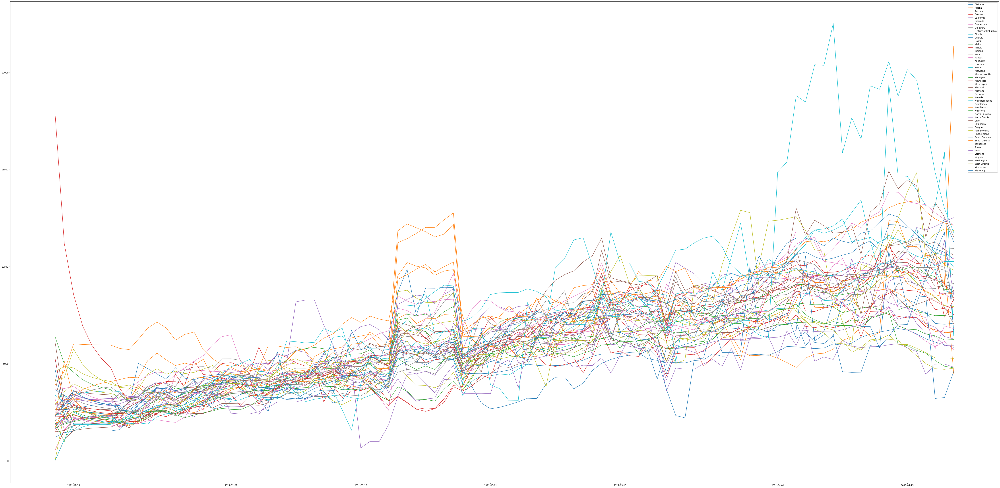

In [156]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["daily_vaccinations_per_million"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

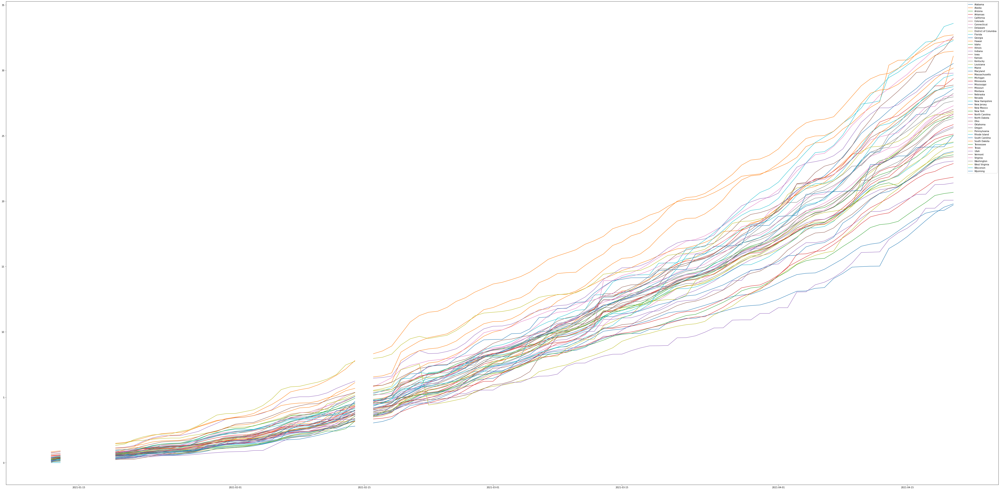

In [157]:
fig= plt.figure(figsize=(80,40))

for state in new_data["state"].unique():
    sub = new_data[new_data["state"] == state]

    x = pd.to_datetime(sub["date"])
    y = sub["people_fully_vaccinated_per_hundred"]

    plt.plot(x, y, label = state)

plt.legend()

plt.show()

In [158]:
len(new_data)

5559

In [159]:
data_without_na = new_data.dropna()

In [160]:
data_without_na.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14',
       

### Policy and mobility

In [161]:
mob = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']
pol = ['stay_at_home',
       'mask_mandate', 'business_open']

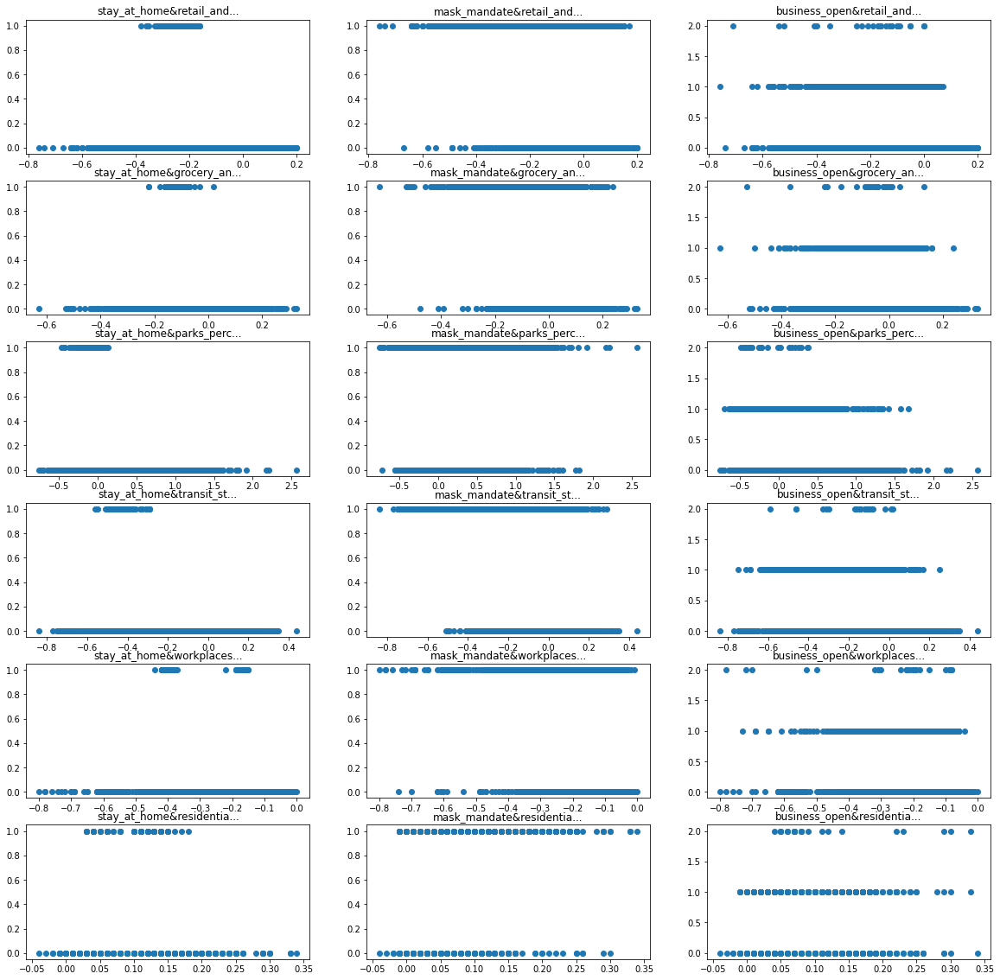

In [162]:
fig = plt.figure(figsize=(20, 20))
axs = fig.subplots(len(mob), len(pol))
for i in range(0, len(pol)):
    for j in range(0, len(mob)):
        axs[j, i].scatter(data_without_na[mob[j]], data_without_na[pol[i]])
        axs[j, i].set_title(pol[i]+"&"+mob[j][:10]+"...")

plt.show()

### Correlation matrix

In [163]:
columns = ['retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline']

In [164]:
X = data_without_na[columns]

In [165]:
X.corr()

,retail_and_recreation_percent_change_from_baseline,grocery_and_pharmacy_percent_change_from_baseline,parks_percent_change_from_baseline,transit_stations_percent_change_from_baseline,workplaces_percent_change_from_baseline,residential_percent_change_from_baseline
retail_and_recreation_percent_change_from_baseline,1.000000,0.868974,0.617132,0.808386,0.524715,-0.723859
grocery_and_pharmacy_percent_change_from_baseline,0.868974,1.000000,0.596800,0.713260,0.500764,-0.681891
parks_percent_change_from_baseline,0.617132,0.596800,1.000000,0.486756,0.325315,-0.574889
transit_stations_percent_change_from_baseline,0.808386,0.713260,0.486756,1.000000,0.603781,-0.746291
workplaces_percent_change_from_baseline,0.524715,0.500764,0.325315,0.603781,1.000000,-0.858674
residential_percent_change_from_baseline,-0.723859,-0.681891,-0.574889,-0.746291,-0.858674,1.000000


In [166]:
corr = X.corr()

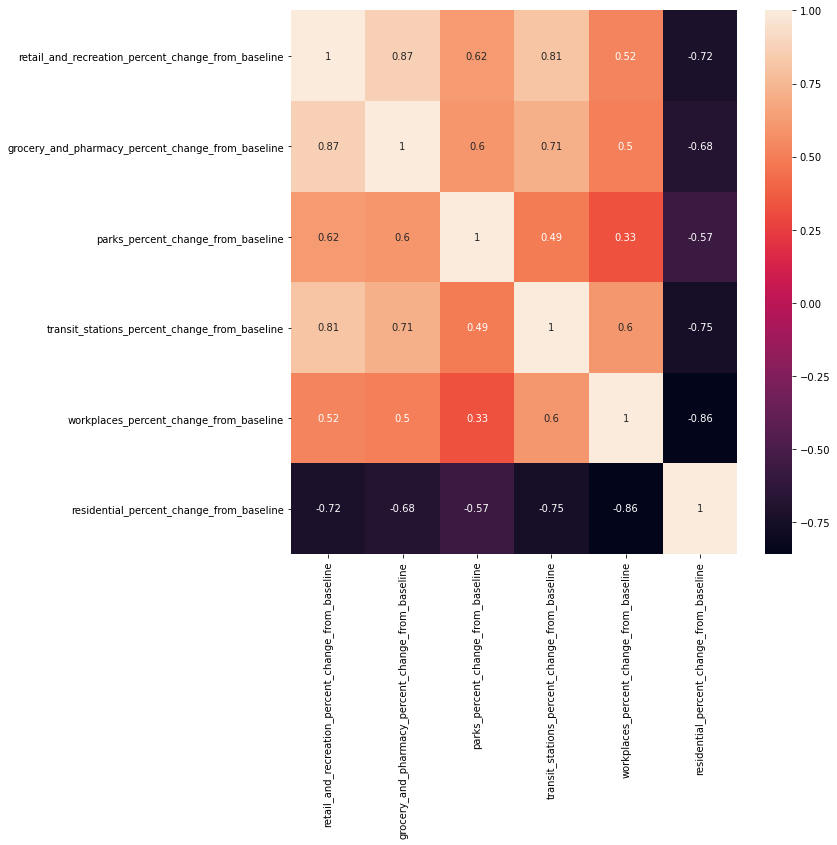

In [167]:
fig= plt.figure(figsize=(10,10))

sn.heatmap(corr, annot=True)
plt.show()

In [168]:
for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[0]):
        if abs(corr.iloc[i,j]) >= 0.85:
            print(i, j, columns[i], columns[j], corr.iloc[i,j])

0 1 retail_and_recreation_percent_change_from_baseline grocery_and_pharmacy_percent_change_from_baseline 0.8689741130830179
4 5 workplaces_percent_change_from_baseline residential_percent_change_from_baseline -0.8586742050134736


### Mobility feature selection

In [169]:
Y2 = data_without_na["new_case_pct"]

In [170]:
columns = [
       'retail_and_recreation_percent_change_lag7',
       'grocery_and_pharmacy_percent_change_lag7', 'parks_percent_change_lag7',
       'transit_stations_percent_change_lag7',
       'workplaces_percent_change_lag7', 'residential_percent_change_lag7',
       'retail_and_recreation_percent_change_lag14',
       'grocery_and_pharmacy_percent_change_lag14',
       'parks_percent_change_lag14', 'transit_stations_percent_change_lag14',
       'workplaces_percent_change_lag14', 'residential_percent_change_lag14'
       ]
features = len(columns)
c = columns.copy()

In [171]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [172]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

retail_and_recreation_percent_change_lag7 5.331675446846144e-06
grocery_and_pharmacy_percent_change_lag7 0.15834928819209304
parks_percent_change_lag7 8.581762035746656e-60
transit_stations_percent_change_lag7 1.2665687288060778e-54
workplaces_percent_change_lag7 5.6753661801575834e-36
residential_percent_change_lag7 1.7997662108752002e-127
retail_and_recreation_percent_change_lag14 0.022966282173108272
grocery_and_pharmacy_percent_change_lag14 0.11074951227833828
parks_percent_change_lag14 1.1487377604743262e-14
transit_stations_percent_change_lag14 5.6163820642243786e-43
workplaces_percent_change_lag14 0.9511401050358408
residential_percent_change_lag14 8.89938535611894e-07


In [173]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])


0.9511401050358408 workplaces_percent_change_lag14
0.15071793910945205 grocery_and_pharmacy_percent_change_lag7
                                 OLS Regression Results                                
Dep. Variable:           new_case_pct   R-squared (uncentered):                   0.360
Model:                            OLS   Adj. R-squared (uncentered):              0.359
Method:                 Least Squares   F-statistic:                              215.9
Date:                Thu, 29 Apr 2021   Prob (F-statistic):                        0.00
Time:                        14:19:47   Log-Likelihood:                          27572.
No. Observations:                3845   AIC:                                 -5.512e+04
Df Residuals:                    3835   BIC:                                 -5.506e+04
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
        

In [174]:
selected_mob_column = ['retail_and_recreation_percent_change_lag7',
                       'parks_percent_change_lag7',
       'transit_stations_percent_change_lag7',
       'residential_percent_change_lag7']

In [175]:
new_data = pd.concat([new_data, pd.get_dummies(new_data["business_open"], prefix="business_open")], axis=1)
new_data.columns

Index(['Unnamed: 0', 'state', 'date',
       'retail_and_recreation_percent_change_from_baseline',
       'grocery_and_pharmacy_percent_change_from_baseline',
       'parks_percent_change_from_baseline',
       'transit_stations_percent_change_from_baseline',
       'workplaces_percent_change_from_baseline',
       'residential_percent_change_from_baseline', 'stay_at_home',
       'mask_mandate', 'business_open', 'people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million', 'submission_date', 'state_abbr',
       'new_case', 'new_case_ma7', 'new_death', 'new_death_ma7',
       'population_density', 'population', 'new_death_growth_rate',
       'new_case_growth_rate', 'new_death_growth_rate_weekly',
       'new_case_growth_rate_weekly', 'new_death_pct', 'new_case_pct',
       'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14',
       

### Vaccine feature selection

In [176]:
columns = ['people_fully_vaccinated_per_hundred',
       'daily_vaccinations_per_million',
        'people_fully_vaccinated_per_hundred_lag7',
       'people_fully_vaccinated_per_hundred_lag14',
       'daily_vaccinations_per_million_lag7',
       'daily_vaccinations_per_million_lag14']
features = len(columns)
c = columns.copy()

In [177]:
X = data_without_na[c]
scaler = RobustScaler() 
X_scaled = scaler.fit_transform(X)

In [178]:
regressor_OLS = sm.OLS(Y2, X_scaled).fit()
for i in range(len(columns)):
    print(columns[i], regressor_OLS.pvalues[i])

people_fully_vaccinated_per_hundred 0.04511669012195284
daily_vaccinations_per_million 0.2619335922437236
people_fully_vaccinated_per_hundred_lag7 1.3031571237737767e-19
people_fully_vaccinated_per_hundred_lag14 4.307593803740157e-42
daily_vaccinations_per_million_lag7 6.023942372334371e-06
daily_vaccinations_per_million_lag14 2.990576266508726e-08


In [179]:
for i in range(0, features):
    X = data_without_na[c]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    regressor_OLS = sm.OLS(Y2, X_scaled).fit()
    maxVar = max(regressor_OLS.pvalues)
    if maxVar > 0.05:
        for j in range(0, features - i):
            if (regressor_OLS.pvalues[j].astype(float) == maxVar):
                print(maxVar, c[j])
                c = np.delete(c, j)
    if maxVar <= 0.05:
        break
                
print(regressor_OLS.summary())
for i in range(len(c)):
    print(c[i], regressor_OLS.pvalues[i])

0.2619335922437236 daily_vaccinations_per_million
                                 OLS Regression Results                                
Dep. Variable:           new_case_pct   R-squared (uncentered):                   0.063
Model:                            OLS   Adj. R-squared (uncentered):              0.061
Method:                 Least Squares   F-statistic:                              51.26
Date:                Thu, 29 Apr 2021   Prob (F-statistic):                    1.33e-51
Time:                        14:19:48   Log-Likelihood:                          26838.
No. Observations:                3845   AIC:                                 -5.367e+04
Df Residuals:                    3840   BIC:                                 -5.364e+04
Df Model:                           5                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025    

In [180]:
from sklearn.preprocessing import PolynomialFeatures

In [181]:
poly = PolynomialFeatures(degree = 3)
c = columns.copy()

In [182]:
for v in c:
    X = data_without_na[[v]]
    scaler = RobustScaler() 
    X_scaled = scaler.fit_transform(X)
    X_poly = poly.fit_transform(X_scaled)
    regressor_OLS = sm.OLS(Y2, X_poly).fit()
    print(v)
    print(regressor_OLS.summary())

people_fully_vaccinated_per_hundred
                            OLS Regression Results                            
Dep. Variable:           new_case_pct   R-squared:                       0.288
Model:                            OLS   Adj. R-squared:                  0.288
Method:                 Least Squares   F-statistic:                     518.1
Date:                Thu, 29 Apr 2021   Prob (F-statistic):          1.01e-282
Time:                        14:19:48   Log-Likelihood:                 30077.
No. Observations:                3845   AIC:                        -6.015e+04
Df Residuals:                    3841   BIC:                        -6.012e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0

In [183]:
select_vac_column = ["people_fully_vaccinated_per_hundred_lag14"]

## General analysis

In [184]:
scaler = RobustScaler() 

In [185]:
c = select_vac_column + selected_mob_column + pol

In [186]:
c

['people_fully_vaccinated_per_hundred_lag14',
 'retail_and_recreation_percent_change_lag7',
 'parks_percent_change_lag7',
 'transit_stations_percent_change_lag7',
 'residential_percent_change_lag7',
 'stay_at_home',
 'mask_mandate',
 'business_open']

In [187]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [188]:
model = LinearRegression().fit(X_train, y_train)

In [189]:
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.13499553089455996

In [190]:
explainer = shap.LinearExplainer(model, X_train)
shap_values = explainer.shap_values(X_test)

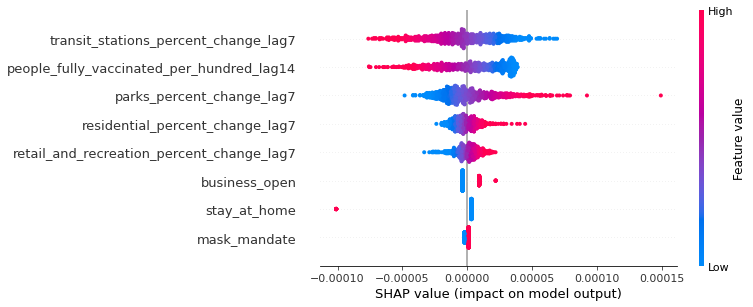

In [191]:
shap.summary_plot(shap_values, X_test)

### Desicion Tree

In [192]:
cols = c.copy()
X = data_without_na[cols]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [193]:
clf = tree.DecisionTreeRegressor(random_state=42)

In [194]:
grid = {'criterion': ["mse", "friedman_mse", "mae", "poisson"],
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [195]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)

In [196]:
clf_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(random_state=42), n_jobs=-2,
             param_grid={'criterion': ['mse', 'friedman_mse', 'mae', 'poisson'],
                         'max_depth': range(2, 13),
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 4]})

In [197]:
clf_random.best_estimator_

DecisionTreeRegressor(max_depth=7, max_features='auto', min_samples_leaf=2,
                      random_state=42)

In [198]:
best_model = clf_random.best_estimator_

In [199]:
best_model.fit(X_train, y_train)
y_pred = best_model.predict(X_test)
r2_score(y_test, y_pred)

0.42994406843337507

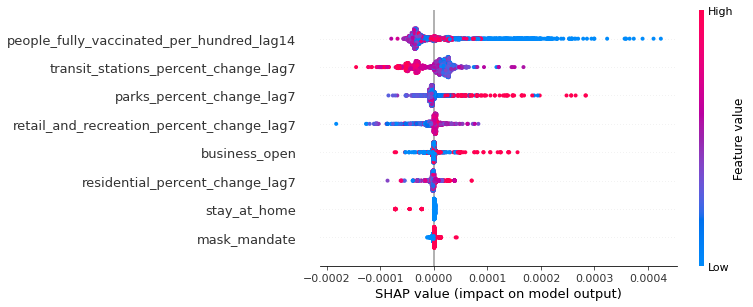

In [200]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

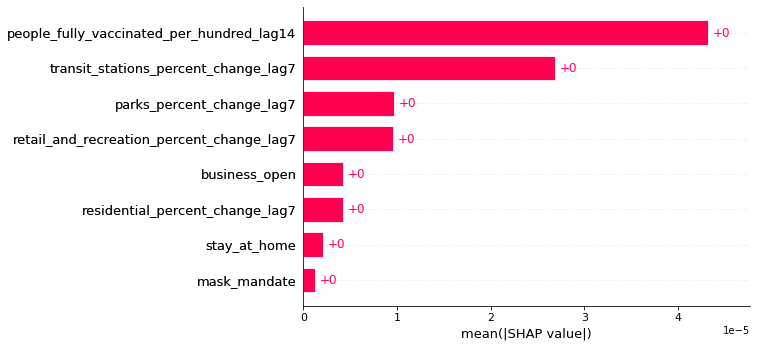

In [201]:
shap.plots.bar(shap_values)

### Random forest

In [202]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)
rf = RandomForestRegressor()

In [203]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [204]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)

In [205]:
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-2,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': range(2, 15, 2),
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'n_estimators': range(200, 2001, 200)},
                   random_state=42, verbose=2)

In [206]:
rf_random.best_params_

{'n_estimators': 1400,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 14,
 'bootstrap': False}

In [207]:
# base_model = 
# base_model.fit(X_train, y_train)
# y_pred = base_model.predict(X_test)
# r2_score(y_test, y_pred)

In [208]:
model = rf_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

0.6293079639674299

In [209]:
explainer = shap.TreeExplainer(model)
shap_values = explainer(X_train)
shap.plots.beeswarm(shap_values)

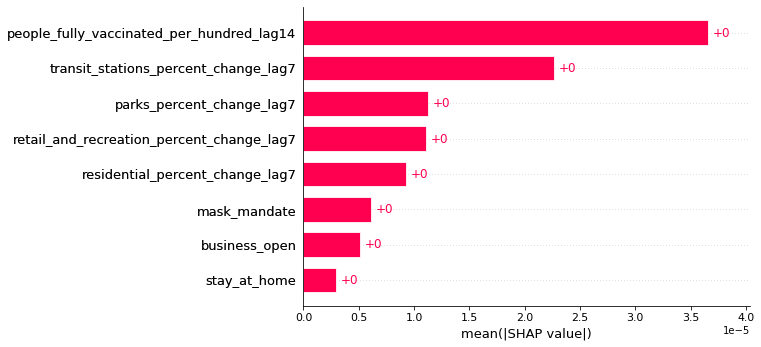

In [71]:
shap.plots.bar(shap_values)

### SVM

In [72]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y2, test_size=0.2, random_state=42)

In [73]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(StandardScaler(), SVR(kernel=k, C=1.0))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear -6.6303789761513885
poly -6.6303789761513885
rbf -6.6303789761513885
sigmoid -6.6303789761513885


In [74]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    regr = make_pipeline(RobustScaler(), SVR(kernel=k, C=1.0, epsilon=0.0001))
    regr.fit(X_train, y_train)
    y_pred = regr.predict(X_test)
    print(k, r2_score(y_test, y_pred))

linear -6.630378976151578
poly -6.630378976151578
rbf -6.630378976151578
sigmoid -6.630378976151578


In [75]:
model = SVR(kernel="poly", C=1.0, epsilon=0.0001)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(r2_score(y_test, y_pred))

-6.630378976151578


In [76]:
explainer = shap.KernelExplainer(model.predict, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

100%|██████████| 50/50 [00:02<00:00, 18.82it/s]


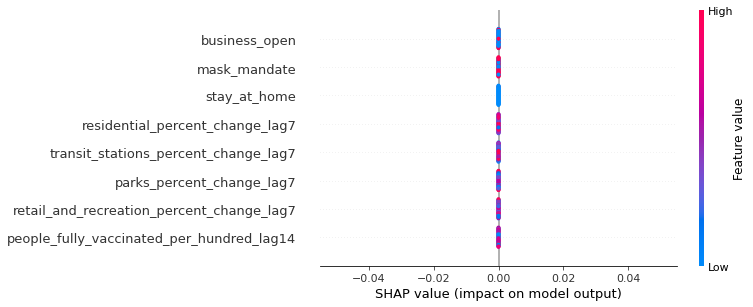

In [77]:
shap.summary_plot(shap_values, X_test[:50])

### KNN

In [78]:
from sklearn.neighbors import KNeighborsRegressor

In [79]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y2, test_size=0.2, random_state=42)

In [80]:
neigh = KNeighborsRegressor()

In [81]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)

In [82]:
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=KNeighborsRegressor(), n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']})

In [83]:
neigh_random.best_estimator_

KNeighborsRegressor(n_neighbors=6, weights='distance')

In [84]:
best_model = neigh_random.best_estimator_
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
r2_score(y_test, y_pred)

-6.630378976151578

In [85]:
explainer = shap.KernelExplainer(best_model.predict, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

100%|██████████| 100/100 [00:44<00:00,  2.23it/s]


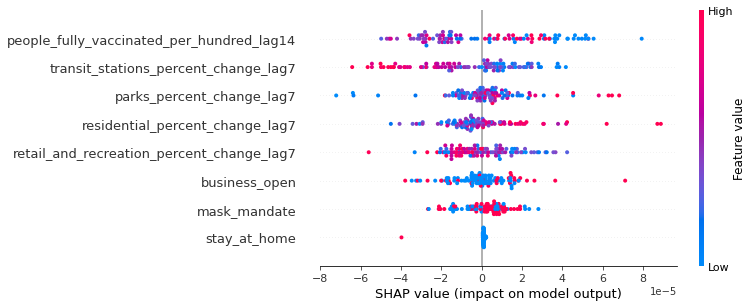

In [86]:
shap.summary_plot(shap_values, X_test[:100])

## Transform Y to categorical data

In [87]:
Y3 = Y2.copy()

In [88]:
Y2.mean()

0.00020210727662692217

In [89]:
from scipy import stats
k2, p = stats.normaltest(Y2)
p

1.2000161428564169e-264

In [90]:
Y3[Y3<Y2.mean()] = 0
Y3[Y3>Y2.mean()] = 1
# Y3[Y3==0] = "below avg"
# Y3[Y3==1] = "above avg"


### Logistic regression

In [91]:
from sklearn.linear_model import LogisticRegression

In [92]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [93]:
clf = LogisticRegression(random_state=42).fit(X_train, y_train)

In [94]:
clf.score(X_test, y_test)

0.6423927178153446

In [95]:
explainer = shap.LinearExplainer(clf, X_train)
shap_values = explainer.shap_values(X_test)

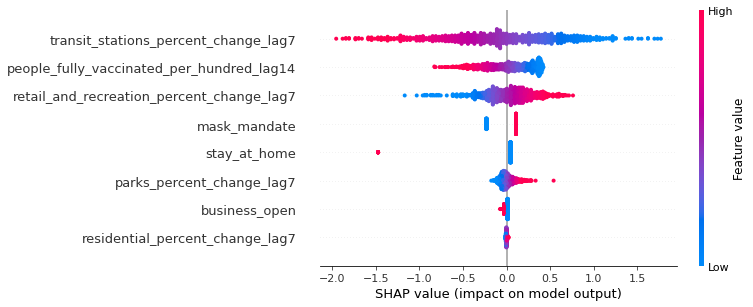

In [96]:
shap.summary_plot(shap_values, X_test)

### Decision Trees

In [97]:
from sklearn.tree import DecisionTreeClassifier

In [98]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)

In [99]:
clf = DecisionTreeClassifier(random_state=42)

In [100]:
grid = {'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 13),
               'min_samples_leaf': [1, 2, 4],}

In [101]:
clf_random = GridSearchCV(estimator = clf, param_grid = grid, cv = 3, n_jobs = -2)
clf_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-2,
             param_grid={'max_depth': range(2, 13),
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 4]})

In [102]:
clf_random.best_estimator_

DecisionTreeClassifier(max_depth=11, max_features='auto', min_samples_leaf=4,
                       random_state=42)

In [104]:
best_model = DecisionTreeClassifier(max_depth=11, max_features='auto', min_samples_leaf=4,
                       random_state=42)
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.7841352405721717

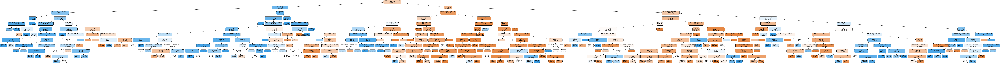

In [105]:
from IPython.display import Image  
import pydotplus
thestring = tree.export_graphviz(best_model, out_file=None,  
                         feature_names=X_train.columns.values, 
                         class_names=['above avg', 'below avg'],  
                         filled=True, rounded=True,  
                         special_characters=True,impurity=False)
graph = pydotplus.graph_from_dot_data(thestring)  
Image(graph.create_png())  

In [106]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

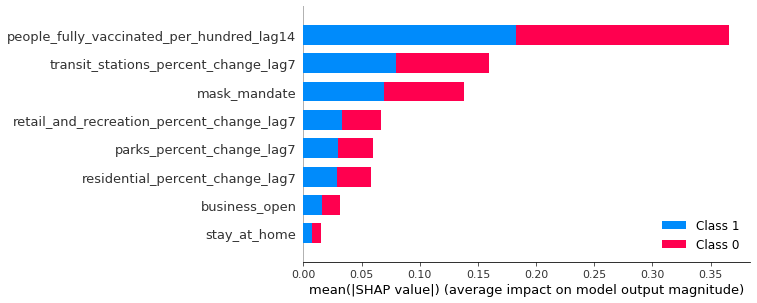

In [107]:
shap.summary_plot(shap_values, X)

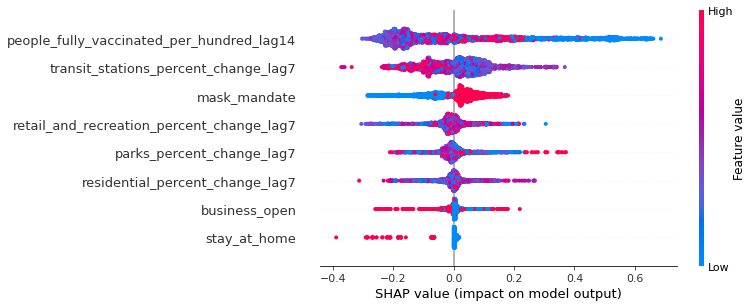

In [108]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values[1], X)

### Random forest

In [109]:
from sklearn.ensemble import RandomForestClassifier

In [110]:
X = data_without_na[c]
X_train, X_test, y_train, y_test = train_test_split(X, Y3, test_size=0.2, random_state=42)
clf = RandomForestClassifier()

In [111]:
grid = {'n_estimators': range(200, 2001, 200),
               'max_features': ['auto', 'sqrt'],
               'max_depth': range(2, 15, 2),
               'min_samples_leaf': [1, 2, 4],
            'bootstrap': [True, False]}

In [112]:
clf_random = RandomizedSearchCV(estimator = clf, param_distributions = grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -2)
clf_random.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


RandomizedSearchCV(cv=3, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-2,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': range(2, 15, 2),
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'n_estimators': range(200, 2001, 200)},
                   random_state=42, verbose=2)

In [113]:
clf_random.best_estimator_

RandomForestClassifier(bootstrap=False, max_depth=14, max_features='sqrt',
                       n_estimators=1400)

In [114]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.8387516254876463

In [115]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)

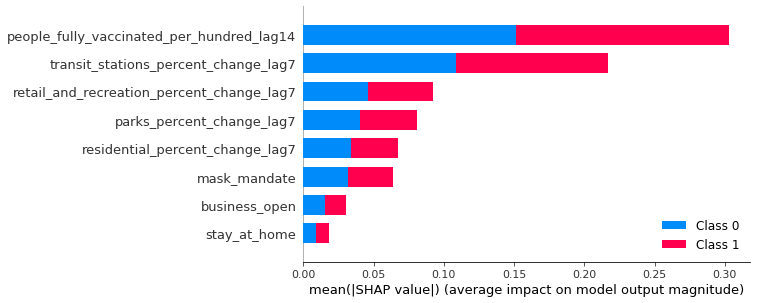

In [116]:
shap.summary_plot(shap_values, X)

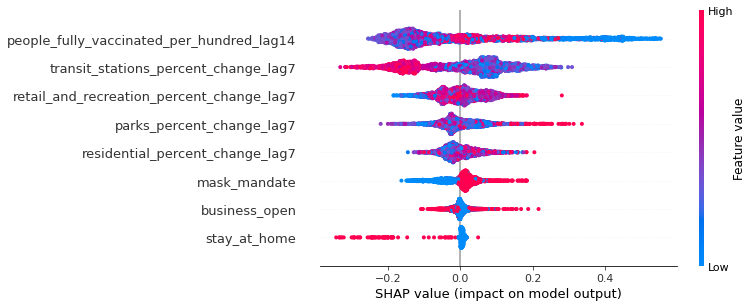

In [117]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values[1], X)

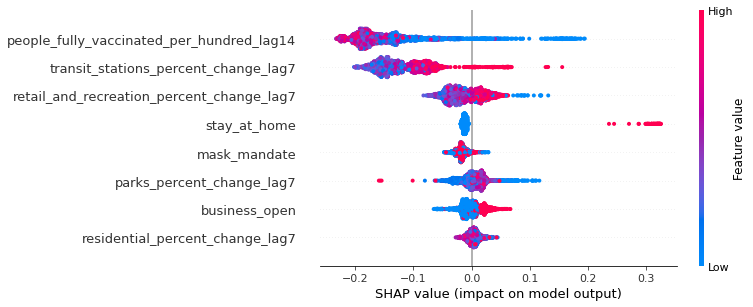

In [133]:
best_model = clf_random.best_estimator_
best_model.fit(X_train, y_train)
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values[0], X)

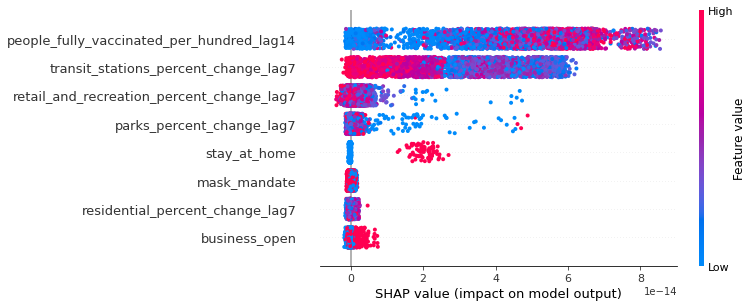

In [134]:
shap.summary_plot(shap_values[0] + shap_values[1], X + X)

In [135]:
len(shap_values[0])

3845

In [138]:
shap_values[0][:10]

array([[ 1.56784732e-01, -3.99886806e-02, -1.55026448e-02,
        -9.44700122e-02, -9.23812568e-03, -7.42818280e-03,
         1.70992127e-02, -1.08389800e-03],
       [ 1.73783842e-01, -4.47772866e-02, -3.94516627e-02,
        -7.27472665e-02,  1.51865198e-02, -7.65431349e-03,
        -1.06411862e-02, -2.49264179e-03],
       [ 1.61930688e-01, -3.62259115e-02, -7.31313501e-03,
        -9.01851654e-02, -3.39477635e-03, -7.36942496e-03,
         1.39100187e-02,  1.19418108e-03],
       [ 1.47863493e-01, -3.24597722e-02, -6.76217430e-03,
        -9.38851150e-02, -1.12523554e-03, -7.28443802e-03,
         1.87676456e-02, -1.08833049e-03],
       [ 1.21226922e-01, -5.10825870e-02, -5.03958992e-02,
        -8.90686398e-02,  4.55631939e-03, -7.93377750e-03,
         1.02764222e-02, -1.01088143e-02],
       [ 4.45016763e-02, -6.53124097e-02, -2.64107550e-03,
        -1.28488492e-01, -3.58211994e-03, -9.88164831e-03,
         7.04899677e-03, -2.45174691e-03],
       [ 4.36834737e-02, -6.044113

In [136]:
len(shap_values[1])

3845

In [139]:
shap_values[1][:10]

array([[-1.56784732e-01,  3.99886806e-02,  1.55026448e-02,
         9.44700122e-02,  9.23812568e-03,  7.42818280e-03,
        -1.70992127e-02,  1.08389800e-03],
       [-1.73783842e-01,  4.47772866e-02,  3.94516627e-02,
         7.27472665e-02, -1.51865198e-02,  7.65431349e-03,
         1.06411862e-02,  2.49264179e-03],
       [-1.61930688e-01,  3.62259115e-02,  7.31313501e-03,
         9.01851654e-02,  3.39477635e-03,  7.36942496e-03,
        -1.39100187e-02, -1.19418108e-03],
       [-1.47863493e-01,  3.24597722e-02,  6.76217430e-03,
         9.38851150e-02,  1.12523554e-03,  7.28443802e-03,
        -1.87676456e-02,  1.08833049e-03],
       [-1.21226922e-01,  5.10825870e-02,  5.03958992e-02,
         8.90686398e-02, -4.55631939e-03,  7.93377750e-03,
        -1.02764222e-02,  1.01088143e-02],
       [-4.45016763e-02,  6.53124097e-02,  2.64107550e-03,
         1.28488492e-01,  3.58211994e-03,  9.88164831e-03,
        -7.04899677e-03,  2.45174691e-03],
       [-4.36834737e-02,  6.044113

### SVM

In [118]:
from sklearn.svm import SVC

In [119]:
for k in ["linear", "poly", "rbf", "sigmoid"]:
    clf = make_pipeline(RobustScaler(), SVC(kernel=k, C=1.0, probability=True))
    clf.fit(X_train, y_train)
    print(k, clf.score(X_test, y_test))

linear 0.6384915474642393
poly 0.717815344603381
rbf 0.8010403120936281
sigmoid 0.5890767230169051


In [120]:
model = SVC(kernel="rbf", C=1.0, probability=True)
scaler = RobustScaler()
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.8023407022106632

In [121]:
explainer = shap.KernelExplainer(model.predict_proba, X_train[:50])
shap_values = explainer.shap_values(X_test[:50], nsamples=100)

100%|██████████| 50/50 [00:45<00:00,  1.11it/s]


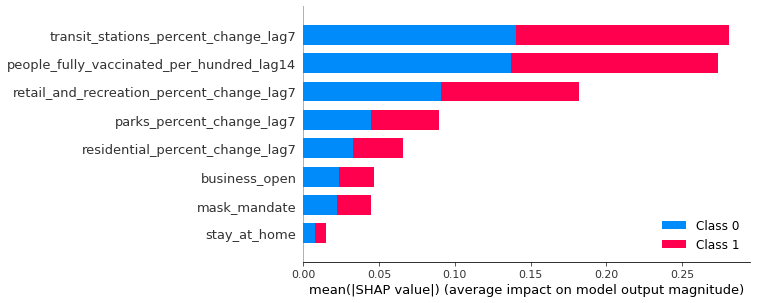

In [122]:
shap.summary_plot(shap_values, X_test[:50])

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 200/200 [12:07<00:00,  3.64s/it]


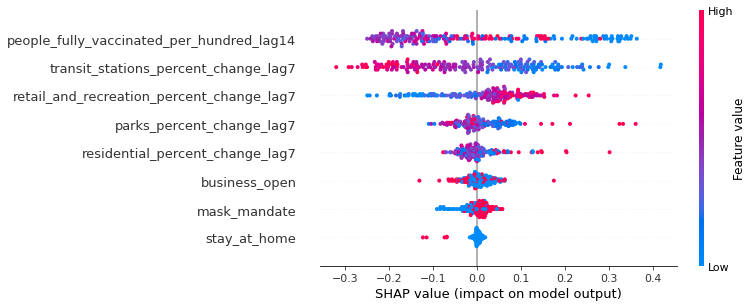

In [123]:
explainer = shap.KernelExplainer(model.predict_proba, X_train[:200])
shap_values = explainer.shap_values(X_test[:200], nsamples=100)
shap.summary_plot(shap_values[1], X_test[:200])

### KNN

In [124]:
from sklearn.neighbors import KNeighborsClassifier

In [125]:
X = data_without_na[c]
X_scaled = scaler.fit_transform(X)
X_scaled_df = pd.DataFrame(X_scaled, columns = X.columns)
X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, Y3, test_size=0.2, random_state=42)

In [126]:
neigh = KNeighborsClassifier()

In [127]:
grid = {"n_neighbors": range(2, 30), "weights": ["uniform", "distance"]}
neigh_random = GridSearchCV(estimator = neigh, param_grid = grid, cv = 3, n_jobs = -2)
neigh_random.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=KNeighborsClassifier(), n_jobs=-2,
             param_grid={'n_neighbors': range(2, 30),
                         'weights': ['uniform', 'distance']})

In [128]:
neigh_random.best_estimator_

KNeighborsClassifier(n_neighbors=8, weights='distance')

In [129]:
best_model = neigh_random.best_estimator_
best_model.fit(X_train, y_train)
best_model.score(X_test, y_test)

0.8153446033810143

In [130]:
explainer = shap.KernelExplainer(best_model.predict_proba, X_train[:100])
shap_values = explainer.shap_values(X_test[:100])

100%|██████████| 100/100 [00:47<00:00,  2.10it/s]


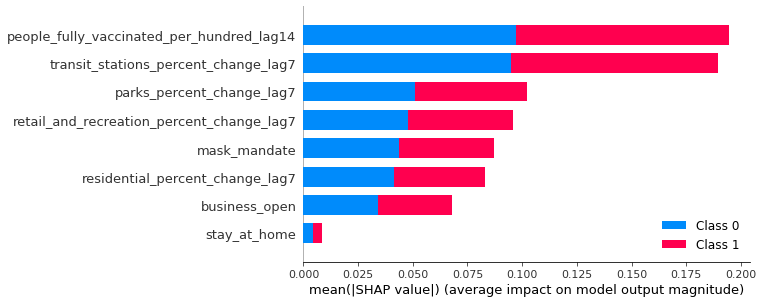

In [131]:
shap.summary_plot(shap_values, X_test[:100])

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 200/200 [01:17<00:00,  2.59it/s]


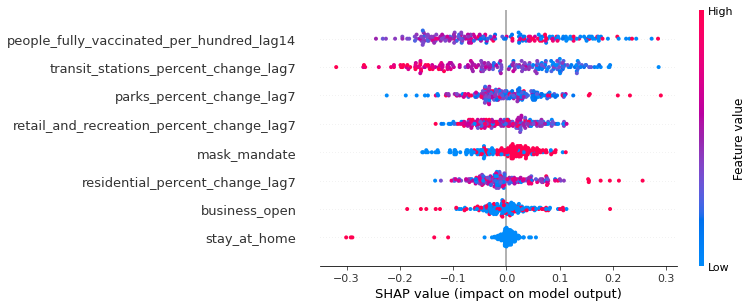

In [132]:
explainer = shap.KernelExplainer(best_model.predict_proba, X_train[:200])
shap_values = explainer.shap_values(X_test[:200], nsamples=100)
shap.summary_plot(shap_values[1], X_test[:200])

## Deep learning model